# Test the hologram performances with HDHD111980 data 30 may 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 3rd 2017


Inspired from Jeremy's work on PN and QSO

> This notebook start from images that has been deflated. So the task. is the following
> 1) Find the central star position
> 2) Find the rotation using the Hessian technique (from Jeremy)
> 3) Turn the images and cut
> 4) save for later analysis

The coordinate of the zero th order must be remember as well as the rotation angle


#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better


- however Jupyter notbook may not save the change !!!!!!!!

In [2]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [3]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/ana_30may17/HD111980


In [4]:
from astropy.modeling import models, fitting

In [5]:
import pandas as pd

# Input directory

- specify which are the input images

In [6]:
inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_30may17"
MIN_IMGNUMBER=58
MAX_IMGNUMBER=190
date="20170530"
object_name='HD111980'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

# Output directory

- specify where are stored the cut images as well as the plot produced

In [7]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

# Location of the spectra

In [8]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 133


# Find various filters

- because the spectra vary from one disperser to another, one must make the list of images identifiers for a given disperser

In [9]:
print all_filt

['dia Thor300', 'dia Thor300', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg

## Define the list of the filter names

- be carefull : these name may change from one run or night to another
- one must change accordingly

In [10]:
filt_names= ['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'Unknown']

## Function to find the list of ids

- one list per disperser

In [11]:
def get_filt_idx(listoffilt):
    
    filt0_idx=[]
    filt1_idx=[]
    filt2_idx=[]
    filt3_idx=[]
    filt4_idx=[]
    filt5_idx=[]
    index=0
    for filt in listoffilt:
        if filt == 'dia Ron400':
            filt0_idx.append(index)
        elif filt == 'dia Thor300':
            filt1_idx.append(index)
        elif filt == 'dia HoloPhP':
            filt2_idx.append(index)
        elif filt == 'dia HoloPhAg':
            filt3_idx.append(index)
        elif filt == 'dia HoloAmAg':
            filt4_idx.append(index)
        else :
            filt5_idx.append(index)
    
        index+=1
    
    filt0_idx=np.array(filt0_idx)
    filt1_idx=np.array(filt1_idx)
    filt2_idx=np.array(filt2_idx)
    filt3_idx=np.array(filt3_idx)
    filt4_idx=np.array(filt4_idx)
    filt5_idx=np.array(filt5_idx)
    
    return filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx
    

- apply the get ids

In [12]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx=get_filt_idx(all_filt)

In [13]:
print 'filt0_idx :: ',filt0_idx
print 'filt1_idx :: ',filt1_idx
print 'filt2_idx :: ',filt2_idx
print 'filt3_idx :: ',filt3_idx
print 'filt4_idx :: ',filt4_idx
print 'filt5_idx :: ',filt5_idx

filt0_idx ::  [  2   7  12  17  22  27  32  37  42  47  52  57  62  67  72  77  82  87
  92  97 102 107 112 117 122 127 132]
filt1_idx ::  [  0   1   3   8  13  18  23  28  33  38  43  48  53  58  63  68  73  78
  83  88  93  98 103 108 113 118 123 128]
filt2_idx ::  [  4   9  14  19  24  29  34  39  44  49  54  59  64  69  74  79  84  89
  94  99 104 109 114 119 124 129]
filt3_idx ::  [  5  10  15  20  25  30  35  40  45  50  55  60  65  70  75  80  85  90
  95 100 105 110 115 120 125 130]
filt4_idx ::  [  6  11  16  21  26  31  36  41  46  51  56  61  66  71  76  81  86  91
  96 101 106 111 116 121 126 131]
filt5_idx ::  []


# Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [105]:
sel_index=0

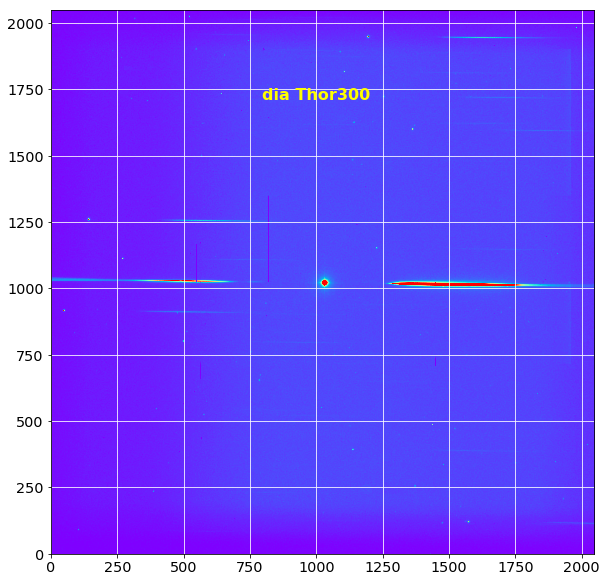

In [106]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [72]:
def Guess_init_fit(theimage,xmin,xmax,ymin,ymax):
    """
   
    
    """
    cropped_image=np.copy(theimage[xmin:xmax,ymin:ymax])
    profile_y=np.sum(cropped_image,axis=1)
    profile_x=np.sum(cropped_image,axis=0)
    
    theidxmax=np.where(profile_x==profile_x.max())
    theidymax=np.where(profile_y==profile_y.max())
    
    return xmin+theidxmax[0][0],ymin+theidymax[0][0]
    

# Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [73]:
x0,y0=Guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [74]:
dw=200  # width

In [87]:
print "x0,y0=",x0,y0

x0,y0= 778 701


In [75]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [76]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [77]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [78]:
z=cropped_image[y,x]

### Notice that with colormesh, one has the same orientation of the image as above

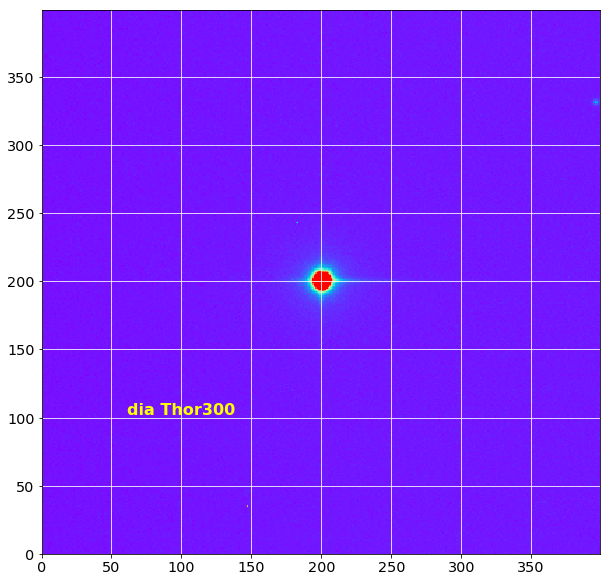

In [79]:
# plot x,y,z
plt.figure(figsize=(10,10))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [80]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 59704.426062


### Make the 2D fit

In [81]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [82]:
import warnings
p = fit_p(p_init, x, y, z)

In [83]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=200.033946597)
Parameter('y_mean', value=200.43797984)
Parameter('amplitude', value=72479.014838)


In [84]:
new_x0=p.x_mean
new_y0=p.y_mean

### I don't really understand the result of this fit

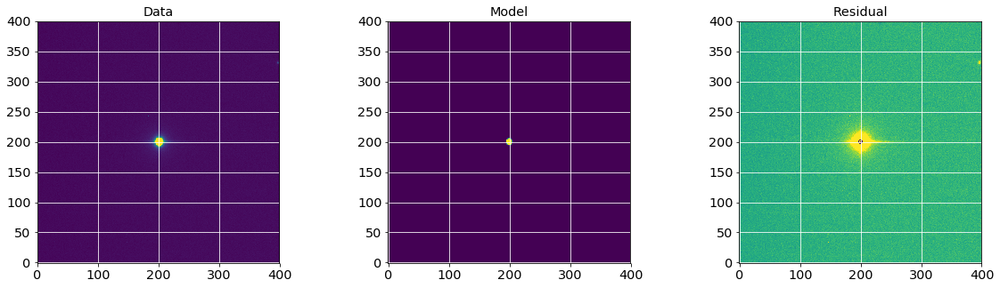

In [85]:
plt.figure(figsize=(20, 5))
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.title("Data")
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.title("Model")
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

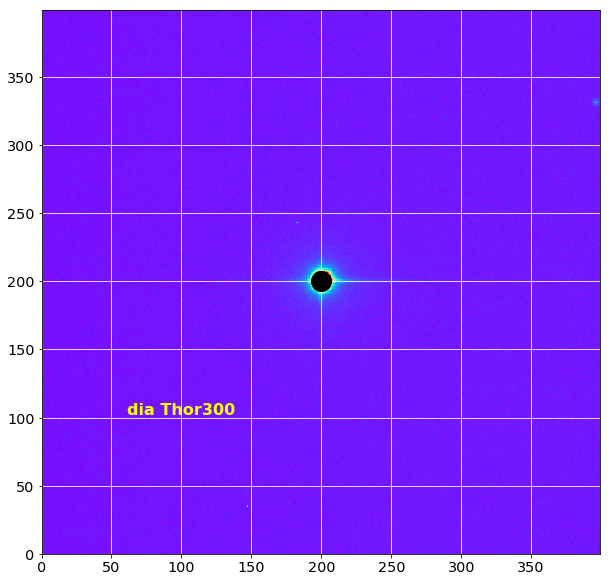

In [86]:
plt.figure(figsize=(10,10))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=20)
plt.grid(color='white', ls='solid')
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

# Show the images

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

IOError: [Errno 24] Too many open files: 'images_notebooks/full_baseanalysis/input_images.pdf'

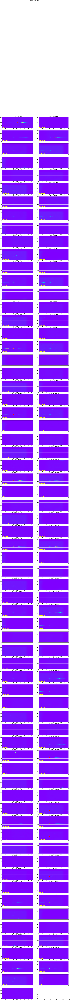

In [63]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

# Show the histograms

- just check the reduction and deflattage is OK

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

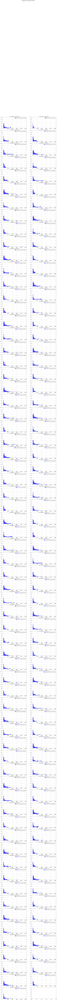

In [32]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

#  Guess central position of the central star

- defines two utility functions


In [33]:
def check_bad_guess(xy_guess,filt_idx, sigma_cut=10.):
    """
    function check_bad_guess(xy_guess,filt_idx)
    
    check is the x or y position are too far from the series of other x,y postion for a given disperser
    
    input :
       xy_guess : the x or the y values to be tested
       filt_idx, the list of identifiers of a given disperser
       
    output:
       the_mean : average position
       the_std. : std deviation
       the_bad_idx : the list of identiers that are at more than 3 sigma 
    """
    
    # typical dispersion
    
    the_guess=xy_guess[filt_idx]
    
    the_mean=np.median(the_guess)
    the_std=np.std(the_guess-the_mean)
    
    the_bad=np.where( np.abs(the_guess-the_mean)> 3.*sigma_cut)
    
    the_bad_idx=filt_idx[the_bad]
    
    return int(the_mean),int(the_std),the_bad_idx

In [1]:
def remove_from_bad(arr,index_to_remove):
    """
    """
    
    newarr=arr
    set_rank_to_remove=np.where(arr==index_to_remove)[0]
    if len(set_rank_to_remove)!=0:
        rank_to_remove=set_rank_to_remove[0]
        newarr=np.delete(arr,rank_to_remove)
    return newarr

In [111]:
def guess_central_position(listofimages,DeltaX,DeltaY,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx):
    """
    Guess the central position of the star
    
    
    output :
         x_guess,y_guess : coordinate of the central star in the frame of the raw image
    """

    
    # Step 1 : do the 2D guassian fit
    
    x_guess = [] 
    y_guess = []
    index=0

    for theimage in listofimages:
        index+=1
        
        # try to find a maximum in the region specified here
        # we expect the central star be found at x0c, y0c
        # overwrite x0c and y0c here !!!!!
        x0c,y0c=Guess_init_fit(theimage,DeltaX[0],DeltaX[1],DeltaY[0],DeltaY[1])
        
        # sub-image around the maximum found at center
        # the coordinate of the lower left corner is (x0c-dwc,y0c-dwc) in original coordinate
        sub_image=np.copy(theimage[y0c-dwc:y0c+dwc,x0c-dwc:x0c+dwc]) # make a sub-image
    
        # init the gaussian fit
        NY=sub_image.shape[0]
        NX=sub_image.shape[1]
        y, x = np.mgrid[:NY,:NX]
        z=sub_image[y,x]
    
        # we expect the central star is at the center of the subimage
        x_mean=NX/2
        y_mean=NY/2
        z_max=z[y_mean,x_mean]
    
        # do the gaussian fit
        p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
        fit_p = fitting.LevMarLSQFitter()
    
        p = fit_p(p_init, x, y, z)
    
        x_fit= p.x_mean
        y_fit= p.y_mean
        z_fit= p.amplitude
    
       
    
        # put the center found by fit in the original image coordinate system
        #--------------------------------------------------------------------
        
        x_star_original=x0c-dwc+x_fit
        y_star_original=y0c-dwc+y_fit
        
        x_guess.append(x_star_original)
        y_guess.append(y_star_original)
        
        #if index%5==0 :
        print index-1,': (x_guess,y_guess)=',x_star_original,y_star_original,'\n'

    x_guess=np.array(x_guess)
    y_guess=np.array(y_guess)
    
    
    # Step 2 : check if the fit is creazy 
    # if so, use the average center for the given disperser
    
    print 'Check fit quality :: '
    print ' ==========================='
    
    # find bad ids for filter 1 and correct for 
        
        
    # filter 0        
    aver_x0,std_x0,bad_idx_x0=check_bad_guess(x_guess,filt0_idx)
    if (bad_idx_x0.shape[0] != 0):
        print 'bad filt 0 x : ',bad_idx_x0
        x_guess[bad_idx_x0]=aver_x0    # do the correction
    
    aver_y0,std_y0,bad_idx_y0=check_bad_guess(y_guess,filt0_idx)
    if (bad_idx_y0.shape[0] != 0):
        print 'bad filt 0 y : ',bad_idx_y0
        y_guess[bad_idx_y0]=aver_y0    # do the correction     
        

    # filter 1        
    aver_x1,std_x1,bad_idx_x1=check_bad_guess(x_guess,filt1_idx)
    if (bad_idx_x1.shape[0] != 0):
        print 'bad filt 1 x : ',bad_idx_x1
        
        # !!!!!!!!!!!!!!!!!!!!!! Special for first Thorlab image
        idx_to_remove=0
        print 'remove from bad idx x1 : ',idx_to_remove
        bad_idx_x1=remove_from_bad(bad_idx_x1,idx_to_remove)           
        print 'new bad filt 1 x : ',bad_idx_x1
        x_guess[bad_idx_x1]=aver_x1    # do the correction
    
    aver_y1,std_y1,bad_idx_y1=check_bad_guess(y_guess,filt1_idx)
    if (bad_idx_y1.shape[0] != 0):
        
        print 'bad filt 1 y : ',bad_idx_y1
         # !!!!!!!!!!!!!!!!!!!!!! Special for first Thorlab image
        idx_to_remove=0        
        print 'remove from bad idx y1 : ',idx_to_remove
        bad_idx_y1=remove_from_bad(ybad_idx_y1,idx_to_remove)           
        print 'new bad filt 1 y : ',bad_idx_y1
        
        y_guess[bad_idx_y1]=aver_y1    # do the correction
    
 
    # filter 2        
    aver_x2,std_x2,bad_idx_x2=check_bad_guess(x_guess,filt2_idx)
    if (bad_idx_x2.shape[0] != 0):
        print 'bad filt 2 x : ',bad_idx_x2
        x_guess[bad_idx_x2]=aver_x2    # do the correction
    
    aver_y2,std_y2,bad_idx_y2=check_bad_guess(y_guess,filt2_idx)
    if (bad_idx_y2.shape[0] != 0):
        print 'bad filt 2 y : ',bad_idx_y2
        y_guess[bad_idx_y2]=aver_y2    # do the correction
        
        
    # filter 3        
    aver_x3,std_x3,bad_idx_x3=check_bad_guess(x_guess,filt3_idx)
    if (bad_idx_x3.shape[0] != 0):
        print 'bad bad filt 3 x : ',bad_idx_x3
        x_guess[bad_idx_x3]=aver_x3    # do the correction
    
    aver_y3,std_y3,bad_idx_y3=check_bad_guess(y_guess,filt3_idx)
    if (bad_idx_y3.shape[0] != 0):
        print 'bad filt 3 y : ',bad_idx_y3
        y_guess[bad_idx_y3]=aver_y3    # do the correction
        
    # filter 4        
    aver_x4,std_x4,bad_idx_x4=check_bad_guess(x_guess,filt4_idx)
    if (bad_idx_x4.shape[0] != 0):
        print 'bad filt 4 x : ',bad_idx_x4
        x_guess[bad_idx_x4]=aver_x4    # do the correction
    
    aver_y4,std_y4,bad_idx_y4=check_bad_guess(y_guess,filt4_idx)
    if (bad_idx_y4.shape[0] != 0):
        print 'bad filt 4 y : ',bad_idx_y4
        y_guess[bad_idx_y4]=aver_y4    # do the correction        
    
    
    return x_guess,y_guess

## Compute the position of central star

In [139]:
# guess the region where the maximum is
Delta_x0=[500,1100]
Delta_y0=[500,1100]
dwc=200

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

0 : (x_guess,y_guess)= 1030.04822153 1020.56040991 

1 : (x_guess,y_guess)= 778.033946597 701.43797984 

2 : (x_guess,y_guess)= 780.487914858 702.066638222 

3 : (x_guess,y_guess)= 780.260692197 702.088215232 

4 : (x_guess,y_guess)= 780.224633554 701.004145141 

5 : (x_guess,y_guess)= 780.635475462 701.334028079 

6 : (x_guess,y_guess)= 780.279874743 700.4620186 

7 : (x_guess,y_guess)= 778.675985822 700.794601937 

8 : (x_guess,y_guess)= 778.772553896 701.944983401 

9 : (x_guess,y_guess)= 778.029902458 700.991294061 

10 : (x_guess,y_guess)= 778.993977655 700.881049203 

11 : (x_guess,y_guess)= 778.010426541 699.696069849 

12 : (x_guess,y_guess)= 776.236812548 700.120787955 

13 : (x_guess,y_guess)= 775.820653912 700.226915685 

14 : (x_guess,y_guess)= 776.263937098 697.248169959 

15 : (x_guess,y_guess)= 776.652894242 697.249977413 

16 : (x_guess,y_guess)= 774.894348515 698.107204011 

17 : (x_guess,y_guess)= 775.621977569 697.494803134 

18 : (x_guess,y_guess)= 775.828258291 698

AttributeError: 'tuple' object has no attribute 'shape'

# Save x_guess, y_guess in a file

In [95]:
ar = {'x_guess' :x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [96]:
df.head()

,x_guess,y_guess
0,753.000000,688.000000
1,778.033947,701.437980
2,749.000000,702.066638
3,780.260692,702.088215
4,780.224634,701.004145


In [97]:
df.tail()

,x_guess,y_guess
128,753.0,689.734357
129,750.0,687.533545
130,749.0,685.587139
131,748.0,688.759366
132,749.0,688.554547


In [98]:
df.describe()

,x_guess,y_guess
count,133.000000,133.000000
mean,750.785680,688.743272
std,16.948245,6.241754
min,719.792655,677.007513
25%,735.121298,684.085986
50%,749.895427,686.867826
75%,766.108775,693.206356
max,780.260692,702.088215


In [99]:
df.to_csv('x_y_guess.csv')

In [100]:
df2=pd.read_csv('x_y_guess.csv')

In [101]:
df2.head()

,Unnamed: 0,x_guess,y_guess
0,0,753.000000,688.000000
1,1,778.033947,701.437980
2,2,749.000000,702.066638
3,3,780.260692,702.088215
4,4,780.224634,701.004145


# Cut image

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

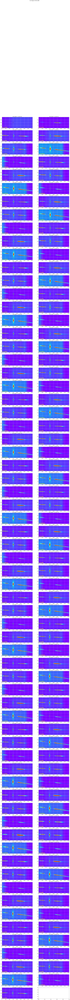

In [102]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

# Save cut images

- save the series of cut images called **images_raw** in a file


In [44]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_058.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_059.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_060.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_061.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_062.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_063.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_064.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_20170530_065.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  2 15:46 cut_fitsimages/cutimg_2

# Find the optimal rotation of the spectra
============================

In [45]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/Users/dagoret/anaconda/lib/python2.7/site-packages/IPython/core/ultratb.py", line 1132, in get_records
  File "/Users/dagoret/anaconda/lib/python2.7/site-packages/IPython/core/ultratb.py", line 313, in wrapped
  File "/Users/dagoret/anaconda/lib/python2.7/site-packages/IPython/core/ultratb.py", line 358, in _fixed_getinnerframes
  File "/Users/dagoret/anaconda/lib/python2.7/inspect.py", line 1048, in getinnerframes
  File "/Users/dagoret/anaconda/lib/python2.7/inspect.py", line 1008, in getframeinfo
  File "/Users/dagoret/anaconda/lib/python2.7/inspect.py", line 453, in getsourcefile
  File "/Users/dagoret/anaconda/lib/python2.7/inspect.py", line 482, in getmodule
  File "/Users/dagoret/anaconda/lib/python2.7/inspect.py", line 466, in getabsfile
  File "/Users/dagoret/anaconda/lib/python2.7/posixpath.py", line 364, in abspath
OSError: [Errno 24] Too many open files


IndexError: string index out of range

## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

In [ ]:
sel=1
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

In [ ]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

In [ ]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

In [ ]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

In [ ]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

In [ ]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
#y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
# really want to see of hessian an straight line math SDC : Sept 25 2017
y_new = y0   + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()


In [ ]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

In [ ]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

# Turn the images accordingly

In [ ]:
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,
                            NBIMGPERROW=2,vmin=500,vmax=10000,oversample_factor=1)
figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
plt.savefig(figfilename)  

# Check rotations

In [ ]:
sel=1
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

ComputeRotationAngleHessian(turned_images,x_guess,DeltaY,all_titles,object_name,
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 50, right_edge = 1600, margin_cut = 10)

In [ ]:
debug=True
if debug:
    for sel in range(len(turned_images)):
        plt.figure(figsize=(25,5))
        plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=10000)
        plt.grid(True)
        plt.title(all_titles[sel])
        plt.grid(color='white', ls='solid')

## Must guess again the new centers for rotation

In [ ]:
# guess the region where the maximum is
x0c2=750 # center expected for the central star
y0c2=110 # center expected for the central star
dwc2=100 # width

x_guess2,y_guess2=guess_central_position(turned_images,x0c2,y0c2,dwc2,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

In [ ]:
ar2 = {'x_guess2' :x_guess2, 'y_guess2' : y_guess2,'theta' :all_theta}
df2 = pd.DataFrame(ar2)

In [ ]:
df2.head()

In [ ]:
df2.to_csv('x_y_guess2.csv')

In [ ]:
DeltaY_rot2 = [50]*len(all_images) # change from 20 to 50 to see well the central star
x_guess_rot2 = x_guess2
y_guess_rot2 = y_guess2
images_cut_rot=ShowCenterImages(x_guess_rot2,y_guess_rot2,DeltaX,DeltaY_rot2,
                    turned_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

# Find the central star locations
======================================

### Central star positions after rotation and cut

In [ ]:
x_guess_rot = x_guess2
y_guess_rot = y_guess2
DeltaY_rot = [100]*len(all_images)
DeltaX_rot = [100]*len(all_images)
# First stage : show the rotated images which were cut
print 'First stage : show the rotated images which were cut'
images_cut=ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,
                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 
# Second stage : show the images cut before they were cut
print 'Second stage : show the images cut before they were cut'
images_cut_before_rot=ShowCenterImages(x_guess,[100]*len(all_images),DeltaX_rot,DeltaY_rot,
                    all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [ ]:
# (JN) valeurs optimisées pour cette étude
img_mean,img_median,img_std,img_sources=ComputeStatImages(images_cut,fwhm=9,threshold=10,sigma=10.0,iters=5)

In [ ]:
print 'total number of images',len(images_cut)
print 'number of centroid found ',len(img_sources)

# Central star postion

take the brightest

In [ ]:
x_star = []
y_star = []
for index,s in enumerate(img_sources):
    for ss in s:
        x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
        y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
x_mean = np.mean(x_star)
y_mean = np.mean(y_star)
img_size=all_images[0].shape
plt.figure(figsize=(5,5))

# plot individual image center
plt.plot(x_star,y_star,'o')
# plot the average postion
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,img_size[1])
plt.ylim(0,img_size[0])
plt.grid(True)

In [ ]:
print 'nuber of x_star = ',len(x_star)
print 'nuber of y_star = ',len(y_star)

> The problem is that DAOFIND may not find a center for each source. Thys the only solution
is to do the same thing : computing the average depending on each filter.

In [ ]:

x_star = []
y_star = []

x_star_f0 = []
y_star_f0 = []

x_star_f1 = []
y_star_f1 = []

x_star_f2 = []
y_star_f2 = []

x_star_f3 = []
y_star_f3 = []

x_star_f4 = []
y_star_f4 = []

missing_centroid = []
missing_centroid_f0 = []
missing_centroid_f1 = []
missing_centroid_f2 = []
missing_centroid_f3 = []
missing_centroid_f4 = []


# loop on all image- source
for index,s in enumerate(img_sources):
    print "star number :",index
    if len(s) == 0:
        print '!! found no centroid'
        missing_centroid.append(index)
        
        if index in filt0_idx:
            missing_centroid_f0.append(index)
        
        if index in filt1_idx:
            missing_centroid_f1.append(index)
            
        if index in filt2_idx:
            missing_centroid_f2.append(index)   
            
        if index in filt3_idx:
            missing_centroid_f3.append(index)     

        if index in filt4_idx:
            missing_centroid_f4.append(index) 
            
    else:
        print 'found ',len(s),' centroid '
        # loop on individual sources in the image
        for ss in s:
            x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
            y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
            if index in filt0_idx:
                x_star_f0.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f0.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
            if index in filt1_idx:
                x_star_f1.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f1.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
            if index in filt2_idx:
                x_star_f2.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f2.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
            if index in filt3_idx:
                x_star_f3.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f3.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])            

            if index in filt4_idx:
                x_star_f4.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star_f4.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])        
        
x_mean = np.mean(x_star)
y_mean = np.mean(y_star)

x0_mean = np.mean(x_star_f0)
y0_mean = np.mean(y_star_f0)



x1_mean = np.mean(x_star_f1)
y1_mean = np.mean(y_star_f1)

x2_mean = np.mean(x_star_f2)
y2_mean = np.mean(y_star_f2)

x3_mean = np.mean(x_star_f3)
y3_mean = np.mean(y_star_f3)

x4_mean = np.mean(x_star_f4)
y4_mean = np.mean(y_star_f4)

print 'SUMMARY ::'
print '=========='

print '\t - Found ', len(x_star_f0), ' for filters ',filt_names[0]
print '\t - Found ', len(x_star_f1), ' for filters ',filt_names[1]
print '\t - Found ', len(x_star_f2), ' for filters ',filt_names[2]
print '\t - Found ', len(x_star_f3), ' for filters ',filt_names[3]
print '\t - Found ', len(x_star_f4), ' for filters ',filt_names[4]

print '\t - Missing centroids for indexes', missing_centroid
print '\t - Missing centroids for filter ',filt_names[0], ' : idx = ',missing_centroid_f0
print '\t - Missing centroids for filter ',filt_names[1], ' : idx = ',missing_centroid_f1
print '\t - Missing centroids for filter ',filt_names[2], ' : idx = ',missing_centroid_f2
print '\t - Missing centroids for filter ',filt_names[3], ' : idx = ',missing_centroid_f3
print '\t - Missing centroids for filter ',filt_names[4], ' : idx = ',missing_centroid_f4

img_size=all_images[0].shape
plt.figure(figsize=(15,5))

# plot individual image center

# plot the average postion
plt.plot(x_mean,y_mean,'ro',label='average position')




plt.plot(x_star_f1,y_star_f1,marker='o',color='lightgreen',label=filt_names[0],lw=0)
plt.plot(x_star_f2,y_star_f2,marker='o',color='cyan',label=filt_names[1],lw=0)
plt.plot(x_star_f3,y_star_f3,marker='o',color='orange',label=filt_names[2],lw=0)
plt.plot(x_star_f4,y_star_f4,marker='o',color='yellow',label=filt_names[3],lw=0)
plt.plot(x_star_f4,y_star_f0,marker='o',color='magenta',label=filt_names[0],lw=0)

plt.plot(x_star,y_star,'k+')

plt.xlim(0,img_size[1])
#plt.ylim(0,img_size[0])
plt.ylim(0,200)
plt.grid(True)
plt.legend()




#### Given DAOFind can find 0 center or more than one, I prefer my guess with a gaussian fit

In [ ]:
# Not done because my initial guess is much better
#tmp = ShowCenterImages(x_star,y_star,DeltaX_rot,DeltaY_rot,
#                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

In [ ]:
tmp = ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

# Zero order positions before rotations

In [ ]:
DeltaY_rot = [50]*len(all_images)
DeltaX_rot = [50]*len(all_images)
y_guess2 = DeltaY
images_raw_cut=ShowCenterImages(x_guess,y_guess2,DeltaX_rot,DeltaY_rot,
                    images_raw,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [ ]:
# (JN) valeurs optimisées pour cette étude
img_mean,img_median,img_std,img_sources=ComputeStatImages(images_raw_cut,fwhm=7,threshold=10,sigma=10.0,iters=5)

##### ! ça marche pas pour moi on j'utilise mon guess

In [ ]:
x_pointing = []
y_pointing = []
for index,s in enumerate(img_sources):
    #for ss in s:
    #    x_pointing.append(ss['xcentroid']+x_guess[index]-DeltaX_rot[index])
    #    y_pointing.append(ss['ycentroid']+y_guess[index]-DeltaY_rot[index])
    x_pointing.append(x_guess[index])
    y_pointing.append(y_guess[index])
    
        
x_mean = np.mean(x_pointing)
y_mean = np.mean(y_pointing)
img_size=all_images[0].shape
order0_positions = np.array([x_pointing,y_pointing]).T
print order0_positions
print x_star
plt.figure(figsize=(5,5))
plt.plot(order0_positions.T[0],order0_positions.T[1],'o')
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,IMSIZE)
plt.ylim(0,IMSIZE)
plt.grid(True)

#####  cherche le nom de l'hologramme

In [ ]:
print all_filt

In [ ]:
all_grat = []
for f in all_filt :
    #all_grat.append(f.replace('RG715 ',''))
    all_grat.append(f.replace('dia ',''))
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    print g,holo.theta(order0_positions[index]), all_theta[index]

## Save results

- Save the cut images after rotation
- Save also info on the position

In [ ]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut_rot[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)
textfilename=os.path.join(outputdir,'star_centroids.txt')
print textfilename
np.savetxt(textfilename,order0_positions,header="y_star x_star",fmt='%d')

!ls -l rotated_fitsimages

In [ ]:
ar3 = {'x_pointing' :x_pointing, 'y_pointing' : y_pointing,'theta' :all_theta}
df3 = pd.DataFrame(ar3)

In [ ]:
df3.to_csv('xy_pointing.csv')

In [ ]:
df3

# Extract spectra
===================================

In [ ]:
outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

inputdir="./rotated_fitsimages"
SelectTagRe='^rotimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^rotimg_%s_[0-9]+.fits$' % date

In [ ]:
df=pd.read_csv('xy_pointing.csv')

In [ ]:
df.head()

In [ ]:
x_star=df["x_pointing"]
y_star=df["y_pointing"]

In [ ]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

In [ ]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

In [ ]:
# Right spectrum
y_star=[60]*len(all_images)

ShowCenterImages([1300]*len(all_images),y_star,[500]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000)
title='Right part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'rightorder.pdf')
plt.savefig(figfilename)  

In [ ]:
# Left spectrum
ShowCenterImages([110]*len(all_images),[60]*len(all_images),[500]*len(all_images),[30]*len(all_images),
                 all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000)
title='Left part of spectrum of {} '.format(object_name)
plt.suptitle(title,size=16)
figfilename=os.path.join(dir_top_images,'leftorder.pdf')
plt.savefig(figfilename)  

# Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

In [ ]:
they0=ShowTransverseProfile(all_images,all_titles,object_name,all_expo,NBIMGPERROW=2,
                      DeltaX=1000,w=5,ws=[20,30],right_edge=1800,ylim=(1e2,2e7))

## Extract the longitudinal spectrum with its lateral bands

In [ ]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(they0,all_images,all_titles,object_name,all_expo,
                                                      w=3,ws=[10,30],right_edge=1800)

In [ ]:
sel=4

plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [ ]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.


In [ ]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [ ]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

In [ ]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

In [ ]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1)

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,object_name,dir_top_images)

## If OK then cleaning

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

In [ ]:
sel=3
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,100.)

In [ ]:
thecorrspectra=CorrectSpectrumFromBackground(thespectra,Clean_Av)

ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2)
figfilename=os.path.join(dir_top_images,'correctedspectrum_profile.pdf')
plt.savefig(figfilename) 

In [ ]:
ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2,xlim=(750,1800))
figfilename=os.path.join(dir_top_images,'correctedspectrum_rightprofile.pdf')
plt.savefig(figfilename) 